In [1]:
import numpy as np
import pandas as pd
import librosa as lb
import os
import h5py
import joblib #並列処理のためのライブラリ
import shutil
from tqdm import tqdm # for文の進捗をプログレスバーで可視化する
import matplotlib.pyplot as plt
import glob
import wave

# 学習済みモデルのロード

In [2]:
from tensorflow.keras import models

autoencoder = models.load_model('./trainedmodel/test_210919_0031/trained_500000_1sec_autoencoder.hd5')

autoencoder.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 128, 32, 3)]      0         
_________________________________________________________________
conv2d (Conv2D)              (None, 128, 32, 16)       448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 64, 16, 16)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 64, 16, 8)         1160      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 32, 8, 8)          0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 32, 8, 8)          584       
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 16, 4, 8)          0     

# HDF5データから教師ラベルをつけたいデータをロード

In [4]:
# hdfファイルの構造確認
def PrintOnlyDataset(name, obj):
    if isinstance(obj, h5py.Dataset):
        print(name)
        print('\t',obj)

testdata = '210919_0031'
data_path = '../オートエンコーダ/data/test_210919_0031/1sec_test-210919_0031_train9d-test1d.hdf5'# テストデータ：1日目
with h5py.File(data_path,'r') as f:
    f.visititems(PrintOnlyDataset)

test_files
	 <HDF5 dataset "test_files": shape (90304, 128, 32, 3), type "<f4">
test_labels
	 <HDF5 dataset "test_labels": shape (90304,), type "|S50">
train_files
	 <HDF5 dataset "train_files": shape (947646, 128, 32, 3), type "<f4">
train_labels
	 <HDF5 dataset "train_labels": shape (947646,), type "|S50">
val_files
	 <HDF5 dataset "val_files": shape (105294, 128, 32, 3), type "<f4">
val_labels
	 <HDF5 dataset "val_labels": shape (105294,), type "|S50">


In [5]:
def load_dataset(label, h5file):
    with h5py.File(h5file, mode='r') as dataset:    
        recording_ids = [i.decode('utf-8') for i in dataset[f'{label}_labels']]
        data = {k:v for k, v in tqdm(zip(recording_ids, dataset[f'{label}_files']), total=len(recording_ids))}
        print(dataset['train_files'].shape)
        print(dataset['val_files'].shape)
        print(dataset['test_files'].shape)
    
    return data

test_data = load_dataset('test', data_path)

100%|██████████████████████████████████████████████████████████████████████████| 90304/90304 [00:11<00:00, 7894.18it/s]

(947646, 128, 32, 3)
(105294, 128, 32, 3)
(90304, 128, 32, 3)


## 時系列にそって教師ラベルを付与するために時系列順にデータをndarrayに格納する

In [6]:
with h5py.File(data_path, mode='r') as dataset:
    test_data_shape = dataset['test_files'].shape
    print(test_data_shape)

(90304, 128, 32, 3)


In [7]:
test_data_value = np.zeros(test_data_shape, dtype=np.float32)
print(test_data_value.shape)

for i in tqdm(range(len(test_data))):
    keyname = str(i)+'_'+testdata
    test_data_value[i] = test_data[keyname]


(90304, 128, 32, 3)


100%|█████████████████████████████████████████████████████████████████████████| 90304/90304 [00:01<00:00, 83758.10it/s]


# 異常度の計算

### オートエンコーダ予測

In [8]:
# GPUメモリが足りない場合はバッチごとに予測
predict_batch_size=256
repnum = int(np.ceil(len(test_data_value) / float(predict_batch_size)))
print(len(test_data_value))
print(repnum)
decoded_imgs =[]
for idx in tqdm(range(repnum)):
    if idx!=repnum-1:
        batch_x = test_data_value[idx * predict_batch_size:(idx + 1) * predict_batch_size]
    else:
        batch_x = test_data_value[idx * predict_batch_size:]
    result = autoencoder.predict_on_batch(batch_x)
    decoded_imgs.append(result)
    
decoded_imgs = np.concatenate(decoded_imgs)
print(decoded_imgs.shape)
print(test_data_value.shape)

90304
353


100%|████████████████████████████████████████████████████████████████████████████████| 353/353 [00:18<00:00, 18.70it/s]


(90304, 128, 32, 3)
(90304, 128, 32, 3)


In [9]:
# decoded_imgs = autoencoder.predict(test_data_value)

### 2乗誤差の算出

In [10]:
anomary = (decoded_imgs-test_data_value)**2
print(anomary.shape)

image_shape = anomary.shape[1:]
print(image_shape)
# 全画素の数
all_pixel_num = np.prod(image_shape) # 総積
print(all_pixel_num)

anomary_sumed = np.zeros(len(anomary))
for i in range(len(anomary)):
    anomary_sumed[i] = np.sum(anomary[i])
    
anomary_scores = anomary_sumed/all_pixel_num
print(anomary_scores.shape)

(90304, 128, 32, 3)
(128, 32, 3)
12288
(90304,)


In [11]:
# 結果のグラフに異常音の帯を表示させるための処理
#正解ラベル（学習データ）のファイルパス
label_data_file = './半教師あり学習/教師ラベル付与/元データ/210919_0031.csv'

label_data_df=pd.read_csv(label_data_file, skiprows=4, usecols=[0, 1], header=None)  # fileをデータフレームに出力
display(label_data_df)
label_array = label_data_df[1].values

,0,1
0,53.4,0
1,52.8,0
2,52.8,0
3,53.2,0
4,53.6,0
...,...,...
431980,57.7,0
431981,58.1,0
431982,58.2,0
431983,58.8,0


### オートエンコーダの出力から教師ラベルの作成

In [12]:
# オートエンコーダが出力した異常度の結果から0.2秒単位の教師ラベルの配列を作る
def give_label(result, duration, thr):
    '''
    result:オートエンコーダが出力した異常度の結果(ndarray)
    duration:オートエンコーダに入力したスペクトログラムの時間幅
    thr:閾値
    '''
    total_time = len(result)*duration
    interval = int(duration/0.2)
    z_anorm = np.zeros(int(total_time/0.2))
    for i in range(len(result)):
        z_anorm[i*interval:(i+1)*interval] = result[i]
    
    z_anorm = np.where(z_anorm >= thr, 1, 0)
    
    return z_anorm

In [13]:
# duration単位の異常度を1秒単位の異常度に変換する
duration = 1 #duration:フレームの時間幅(sec)
thr = 0.002 # 閾値
z_anorm = give_label(anomary_scores, duration, thr) # 教師ラベルの作成
print(z_anorm)
print(np.bincount(z_anorm))
print(len(z_anorm))

[0 0 0 ... 0 0 0]
[450120   1400]
451520


### 作成した教師ラベルを元の正解ラベルに追加する

In [14]:
z_anorm = z_anorm[:len(label_array)] # 音声データと騒音レベルデータの長さが異なるので長さをそろえる
print(len(z_anorm))
print(len(label_array))

added_label = label_array
added_label = np.where(z_anorm == 1, 1, added_label) # 作成した教師ラベルが1なら1，0ならそのまま

print(np.bincount(z_anorm))
print(np.bincount(label_array))
print(np.bincount(added_label))

added_label_df = pd.DataFrame(added_label) # 最終的なラベルのデータフレーム
display(added_label_df)

431985
431985
[430645   1340]
[427158   4827]
[426246   5739]


,0
0,0
1,0
2,0
3,0
4,0
...,...
431980,0
431981,0
431982,0
431983,0


### 最終的なラベルの結果を可視化

In [15]:
# 0.２秒単位の教師ラベルを1秒単位のラベルに変換する
def label_to_sec(label):
    import numpy as np
    unit_sec = int(1/0.2)
    label_sec_array = label[::unit_sec]

    return label_sec_array

#### 緑が元の異常ラベル，青が追加する異常ラベル

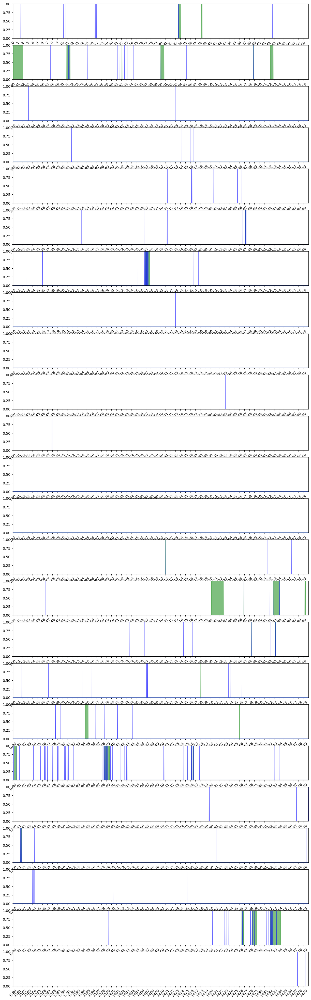

In [16]:
# 0.2秒単位の正解ラベル1秒単位の正解ラベルに変換する
label_array_sec_array = label_to_sec(label_array) # 元の正解ラベル
z_anorm_sec_array = label_to_sec(z_anorm) # 作成した正解ラベル
added_label_sec_array = label_to_sec(added_label) # 追加した正解ラベル

label_time_axis = np.arange(len(added_label_sec_array))/60
graphnum = -(-len(label_time_axis)//3600) 

fig, ax = plt.subplots(graphnum, 1, figsize=(15, 50))
for i in range(graphnum):
    ax[i].set_xlim(60*i, 60*(i+1))
    ax[i].set_ylim(0, 1)
    ax[i].set_xticks(np.arange(60*i, 60*(i+1)))
    ax[i].xaxis.set_tick_params(rotation=45) # オブジェクト指向インターフェイスでの軸ラベルの回転
    ax[i].fill_between(label_time_axis, label_array_sec_array, color = 'green', alpha=0.5)
    ax[i].fill_between(label_time_axis, z_anorm_sec_array, color = 'blue', alpha=0.5)

#### 最終的なラベル

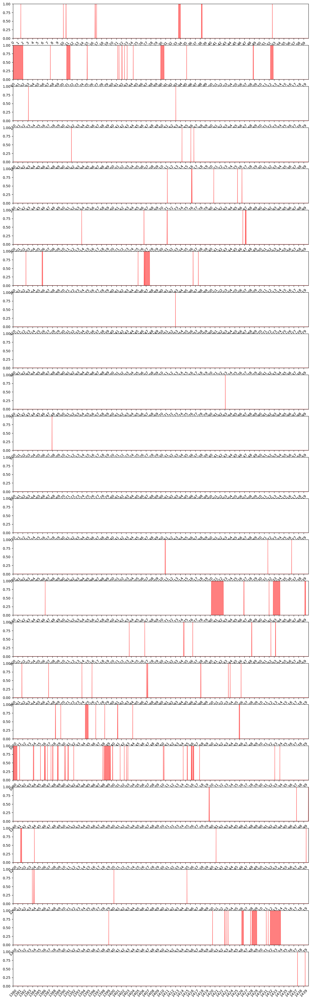

In [17]:
fig, ax = plt.subplots(graphnum, 1, figsize=(15, 50))
for i in range(graphnum):
    ax[i].set_xlim(60*i, 60*(i+1))
    ax[i].set_ylim(0, 1)
    ax[i].set_xticks(np.arange(60*i, 60*(i+1)))
    ax[i].xaxis.set_tick_params(rotation=45) # オブジェクト指向インターフェイスでの軸ラベルの回転
    ax[i].fill_between(label_time_axis, added_label_sec_array, color = 'red', alpha=0.5)

### 最終的なラベルのデータフレームから正常音の時間を抜き出す

In [18]:
# 正常尾を抜き出す
def clipping_normal(label):
    '''
    label:教師ラベルのデータフレーム(ラベルの列だけ)，0:正常, 1:異常
    戻り値:
        list_start:正常音の開始時間を格納したリスト
        list_duration:正常音の継続時間を格納したリスト
        
    '''
    list_start = [] # 正常音の開始時間(s)
    list_duration = []# 正常音の時間長(s)
    search= 1 if label.iloc[0, 0]==0 else 0 #なんのラベルを探すか（searchが1のときはラベルが1(または2)の行を探す）
    start = 0
    for num in range(len(label)):
        if search==0 and (label.iloc[num, 0]==search): #学習データのラベルが1または2のとき異常
            start=num
            search=1
        elif search==1 and label.iloc[num, 0]==search:
            stop=num-1
            duration = (stop-start)*0.2
            list_start.append(start*0.2)
            list_duration.append(duration)
            search=0
    # 学習データの最後のラベルが異常音の場合下の処理が必要
    if start>stop:
        stop=len(label)-1
        duration = (stop-start)*0.2
        list_duration.append(duration)
        
    return list_start, list_duration

In [19]:
# 異常音を抜き出す
def clipping_anorm(label):
    '''
    label:教師ラベルのデータフレーム(ラベルの列だけ)，0:正常, 1:異常
    戻り値:
        list_start:異常音の開始時間を格納したリスト
        list_duration:異常音の継続時間を格納したリスト
        
    '''
    list_start = [] # 正常音の開始時間(s)
    list_duration = []# 正常音の時間長(s)
    search= 1 if label.iloc[0, 0]==0 else 0 #なんのラベルを探すか（searchが1のときはラベルが1(または2)の行を探す）
    start = 0
    for num in range(len(label)):
        if search==1 and (label.iloc[num, 0]==search): #学習データのラベルが1または2のとき異常
            start=num
            search=0
        elif search==0 and label.iloc[num, 0]==search:
            stop=num-1
            duration = (stop-start)*0.2
            list_start.append(start*0.2)
            list_duration.append(duration)
            search=1
    # 学習データの最後のラベルが異常音の場合下の処理が必要
    if start>stop:
        stop=len(label)-1
        duration = (stop-start)*0.2
        list_duration.append(duration)
        
    return list_start, list_duration

In [20]:
# list_start, list_duration = clipping_normal(added_label_df)
list_start, list_duration = clipping_anorm(added_label_df)
print("list_start:", list_start)
print("list_duration:", list_duration)

list_start: [96.0, 615.0, 646.0, 1000.0, 1004.0, 1019.0, 2017.0, 2295.0, 3160.0, 3605.0, 4056.0, 4255.0, 4504.0, 4877.0, 4893.0, 4927.0, 4959.0, 4991.0, 5065.0, 5400.0, 5716.0, 6525.0, 6737.0, 7389.0, 9184.0, 11513.0, 12859.0, 12967.0, 13004.0, 16281.0, 16575.0, 16580.0, 16582.0, 16846.0, 17135.0, 17189.0, 18838.0, 19596.0, 19877.0, 19880.0, 20800.0, 20830.0, 20840.0, 21759.0, 21955.0, 23124.0, 23197.0, 23205.0, 23207.0, 23794.0, 23858.0, 27180.0, 34987.0, 36476.0, 48653.0, 49905.0, 50194.0, 50793.0, 52817.0, 53212.0, 53520.0, 53570.0, 53955.0, 55417.0, 55606.0, 56077.0, 56085.0, 56190.0, 56907.0, 57142.0, 57197.0, 57709.0, 58035.0, 58441.0, 58563.0, 59227.0, 59237.0, 59241.0, 59887.0, 60224.0, 60246.0, 60379.0, 61717.0, 61719.0, 61783.0, 62082.0, 62209.0, 62318.0, 62474.0, 62476.0, 62478.0, 62659.0, 63955.0, 64806.0, 64812.0, 64882.0, 65048.0, 65055.0, 65136.0, 65184.0, 65188.0, 65192.0, 65195.0, 65221.0, 65264.0, 65284.0, 65343.0, 65346.0, 65352.0, 65428.0, 65438.0, 65440.0, 65469.0,

In [21]:
import IPython
from IPython.display import display

test_file = '../data/16000hz騒音データとスタートを合わせた音データ/210919_0031.wav'
for offset, length in tqdm(zip(list_start, list_duration)):
    print(offset/60)
    y, sr = lb.load(test_file, sr = None, offset=offset, duration=length)
    display(IPython.display.Audio(y, rate=sr))

0it [00:00, ?it/s]

1.6


1it [00:01,  1.21s/it]

10.25


10.766666666666667


16.666666666666668


16.733333333333334


16.983333333333334


33.61666666666667


38.25


52.666666666666664


60.083333333333336


10it [00:01,  9.77it/s]

67.6


70.91666666666667


75.06666666666666


81.28333333333333


81.55


82.11666666666666


82.65


83.18333333333334


84.41666666666667


90.0


95.26666666666667


108.75


112.28333333333333


23it [00:01, 24.43it/s]

123.15


153.06666666666666


191.88333333333333


214.31666666666666


216.11666666666667


216.73333333333332


271.35


276.25


276.3333333333333


276.3666666666667


280.76666666666665


285.5833333333333


286.48333333333335


313.96666666666664


326.6


331.28333333333336


331.3333333333333


346.6666666666667


347.1666666666667


347.3333333333333


362.65


365.9166666666667


385.4


386.6166666666667


386.75


386.78333333333336


49it [00:01, 59.40it/s]

396.56666666666666


397.6333333333333


453.0


583.1166666666667


607.9333333333333


810.8833333333333


831.75


836.5666666666667


846.55


880.2833333333333


886.8666666666667


892.0


892.8333333333334


899.25


923.6166666666667


64it [00:01, 64.72it/s]

926.7666666666667


934.6166666666667


934.75


936.5


948.45


952.3666666666667


953.2833333333333


961.8166666666667


967.25


974.0166666666667


976.05


987.1166666666667


987.2833333333333


987.35


998.1166666666667


1003.7333333333333


1004.1


1006.3166666666667


1028.6166666666666


1028.65


1029.7166666666667


1034.7


1036.8166666666666


1038.6333333333334


1041.2333333333333


1041.2666666666667


1041.3


1044.3166666666666


1065.9166666666667


1080.1


1080.2


95it [00:01, 102.34it/s]

1081.3666666666666


1084.1333333333334


1084.25


1085.6


1086.4


1086.4666666666667


1086.5333333333333


1086.5833333333333


1087.0166666666667


1087.7333333333333


1088.0666666666666


1089.05


1089.1


1089.2


1090.4666666666667


1090.6333333333334


1090.6666666666667


1091.15


1091.2666666666667


1092.35


1098.2666666666667


1098.3166666666666


1098.5666666666666


1098.6166666666666


1099.7333333333333


1099.7666666666667


121it [00:02, 132.49it/s]

1100.2166666666667


1100.2666666666667


1101.7666666666667


1102.6


1103.05


1103.3333333333333


1110.5166666666667


1110.6666666666667


1114.5666666666666


1115.3666666666666


1115.4166666666667


1116.2


1116.2833333333333


1116.35


1116.5333333333333


1116.7166666666667


1117.8833333333334


1133.15


1134.1833333333334


1179.8


1179.85


1197.5666666666666


1199.9666666666667


1200.0166666666667


1201.5666666666666


1204.3666666666666


1241.2333333333333


1259.5166666666667


1263.95


1264.2166666666667


1264.3333333333333


1280.5


1295.3333333333333


1339.45


1360.5166666666667


1363.0


157it [00:02, 180.18it/s]

1363.0666666666666


1363.4166666666667


1363.7


1366.45


1368.2166666666667


1368.5166666666667


1371.4333333333334


1371.8166666666666


1372.2333333333333


1437.7666666666667


1439.3166666666666


168it [00:02, 74.39it/s] 
